In [28]:
import json
import jsonlines
import os
import pandas as pd
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import numpy as np
from sklearn.metrics import roc_auc_score, log_loss, f1_score, confusion_matrix, classification_report
import random

In [14]:
pred= pd.read_csv('test_result/incep_res_0403.csv')
pred

,image_id,dir,label,pred,confidence score
0,토스 만보_459.jpg,../Data/carbon_reduction/10kwalking,10kwalking,10kwalking,0.999351
1,캐시워크 만보_262.jpg,../Data/carbon_reduction/10kwalking,10kwalking,10kwalking,0.999483
2,아이폰 걸음수_192.jpg,../Data/carbon_reduction/10kwalking,10kwalking,10kwalking,0.999304
3,삼성헬스 만보_352.jpg,../Data/carbon_reduction/10kwalking,10kwalking,10kwalking,0.999679
4,아이폰 걸음수_408.jpg,../Data/carbon_reduction/10kwalking,10kwalking,10kwalking,0.999682
...,...,...,...,...,...
3995,양치컵_310.jpg,../Data/carbon_reduction/cup/양치컵_네이버,cup,cup,0.999634
3996,양치컵_256.jpg,../Data/carbon_reduction/cup/양치컵_네이버,cup,cup,0.999704
3997,양치컵_250.jpg,../Data/carbon_reduction/cup/양치컵_네이버,cup,cup,0.999633
3998,양치컵_114.jpg,../Data/carbon_reduction/cup/양치컵_네이버,cup,cup,0.999681


In [15]:
test_acc = np.sum(pred.label == pred.pred) / len(pred)
test_matrix = confusion_matrix(pred['label'], pred['pred'])
epoch_f1 = f1_score(pred['label'], pred['pred'], average='macro')

print(f'accuracy: {test_acc:.4f}')
print(f'f1_score: {epoch_f1:.4f}')
print(f'confusion_matrix \n-------------------------\n {test_matrix}')

accuracy: 0.8850
f1_score: 0.8938
confusion_matrix 
-------------------------
 [[386   0   0   2   8   4   0   0   0   0]
 [  0 382   0   0  16   1   1   0   0   0]
 [  0   1 362   2  26   2   0   7   0   0]
 [  0   0   0 307  92   1   0   0   0   0]
 [  0   3   7   8 354   8   3   5   3   9]
 [  0   1   3  25  90 281   0   0   0   0]
 [  0   0   1   1  79   0 319   0   0   0]
 [  0   0   1   2   5   0   1 391   0   0]
 [  0   0   0   1  13   1   0   0 385   0]
 [  0   0   0   0  27   0   0   0   0 373]]


In [16]:
non_matched_idx = pred['label'] != pred['pred']
non_matched = pred[non_matched_idx].reset_index(inplace = False, drop=True)

non_matched.sort_values(by=['image_id'],ascending=True, inplace=True)
tmp = non_matched['image_id'].value_counts().index.sort_values()
non_matched

,image_id,dir,label,pred,confidence score
215,08537cef-9c6e-4426-a624-d72caf2571bd_jpg.rf.61...,../Data/carbon_reduction/can,can,else,0.993281
58,2652_jpg.rf.84b4ccc846bc1b91e43d984b75c4b67c.jpg,../Data/carbon_reduction/pet,pet,cup,0.965881
59,4571_jpg.rf.10470e351158e9e4f9df23a9b83c0470.jpg,../Data/carbon_reduction/pet,pet,else,0.588359
206,579d5d2f-5af5-4e2e-86e5-1dbdcdf8a603_jpg.rf.d1...,../Data/carbon_reduction/can,can,else,0.999476
214,645dc267-fab9-437f-9bb8-9f86f04ceba5_jpg.rf.b5...,../Data/carbon_reduction/can,can,else,0.999952
...,...,...,...,...,...
15,지하철 역_170.jpg,../Data/carbon_reduction/public_vehicle/지하철 역,public_vehicle,else,0.987638
11,캐시워크 만보_099.jpg,../Data/carbon_reduction/10kwalking,10kwalking,else,0.987044
5,캐시워크 만보_449.jpg,../Data/carbon_reduction/10kwalking,10kwalking,else,0.998587
2,토스 만보_051.jpg,../Data/carbon_reduction/10kwalking,10kwalking,else,0.998890


In [24]:
## show img status

back = 0
plt.figure(figsize=(16,500))
for i in range(len(non_matched)):
    plt.subplot(100,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
        
    path = non_matched['dir'][i] + '/' + non_matched['image_id'][i]
    try:
    # im_bgr = cv2.imread(path)
    # im_rgb = im_bgr[:, :, ::-1]
        temp = Image.open(path).convert("RGB")
        image = np.array(temp).copy()
        temp.close()

        plt.imshow(image, cmap=plt.cm.binary)
        plt.xlabel(non_matched['label'][i] + ' : ' + non_matched['pred'][i], loc='left', fontsize=10)
    except:
        plt.xlabel(path + '\n' + non_matched['label'][i] + ' : ' + non_matched['pred'][i], loc='left', fontsize=10)
        
plt.show()

In [58]:
dir_path = "../Data/annotations/"
ano = "captions_train2017.json"

with open(dir_path+ano, 'r') as open_ano:
    ano_json = json.load(open_ano)
annotations = pd.DataFrame(ano_json['annotations'])

for i in range(len(annotations['image_id'])):
    annotations['image_id'][i] = str(annotations['image_id'][i]).zfill(12) + '.jpg'
    
annotations

/tmp/ipykernel_19032/157605491.py:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  annotations['image_id'][i] = str(annotations['image_id'][i]).zfill(12) + '.jpg'


,image_id,id,caption
0,000000203564.jpg,37,A bicycle replica with a clock as the front wh...
1,000000322141.jpg,49,A room with blue walls and a white sink and door.
2,000000016977.jpg,89,A car that seems to be parked illegally behind...
3,000000106140.jpg,98,A large passenger airplane flying through the ...
4,000000106140.jpg,101,There is a GOL plane taking off in a partly cl...
...,...,...,...
591748,000000133071.jpg,829655,a slice of bread is covered with a sour cream ...
591749,000000410182.jpg,829658,A long plate hold some fries with some sliders...
591750,000000180285.jpg,829665,Two women sit and pose with stuffed animals.
591751,000000133071.jpg,829693,White Plate with a lot of guacamole and an ext...


In [78]:
# flickr annotations
dir_path = "../../disk/Data/"
ano = "results.csv"

annotations = pd.read_csv(dir_path+ano, delimiter='|')
annotations.rename(columns={'image_name' : 'image_id'}, inplace=True)
annotations.rename(columns={ ' comment' : 'caption'}, inplace=True)
annotations

,image_id,comment_number,caption
0,1000092795.jpg,0,Two young guys with shaggy hair look at their...
1,1000092795.jpg,1,"Two young , White males are outside near many..."
2,1000092795.jpg,2,Two men in green shirts are standing in a yard .
3,1000092795.jpg,3,A man in a blue shirt standing in a garden .
4,1000092795.jpg,4,Two friends enjoy time spent together .
...,...,...,...
158910,998845445.jpg,0,A man in shorts and a Hawaiian shirt leans ov...
158911,998845445.jpg,1,"A young man hanging over the side of a boat ,..."
158912,998845445.jpg,2,A man is leaning off of the side of a blue an...
158913,998845445.jpg,3,"A man riding a small boat in a harbor , with ..."


In [ ]:
## open_image extraction
image_id = []
captions = []
dir_path = "../Data/annotations/"
ano = "open_images_train_v6_captions.jsonl"

with jsonlines.open(dir_path+ano, 'r') as f:
    for line in f.iter():
        #if line['image_id'][0] == '0':
        image_id.append(line['image_id']+'.jpg')
        captions.append(line['caption'])
annotations = pd.DataFrame(image_id, columns=['image_id'])
annotations['caption'] = captions
annotations

In [79]:
non_matched_idx = (pred_oi['label'] != 1) & (pred_oi['label'] != pred_oi['pred'])
non_matched = pred_oi[non_matched_idx].reset_index(inplace = False, drop=True)

non_matched.sort_values(by=['image_id'],ascending=True, inplace=True)
tmp = non_matched['image_id'].value_counts().index.sort_values()
non_matched

,image_id,dir,label,pred,confidence score
11,1394319096.jpg,../../disk/Data/flickr30k_images,0,1,0.982482
7,207731022.jpg,../../disk/Data/flickr30k_images,0,1,0.999721
2,2915538325.jpg,../../disk/Data/flickr30k_images,0,1,0.863890
9,3225310099.jpg,../../disk/Data/flickr30k_images,0,1,0.999288
1,3553056438.jpg,../../disk/Data/flickr30k_images,0,1,0.953657
5,3606093421.jpg,../../disk/Data/flickr30k_images,0,1,0.592516
10,38437776.jpg,../../disk/Data/flickr30k_images,0,1,0.998950
4,4196910318.jpg,../../disk/Data/flickr30k_images,0,1,0.587664
0,4204621843.jpg,../../disk/Data/flickr30k_images,0,1,0.969537
6,4467116231.jpg,../../disk/Data/flickr30k_images,0,1,0.771683


In [ ]:
non_matched_merged = pd.merge(non_matched, annotations, how='left', left_on='image_id', right_on='image_id')
non_matched_merged

In [ ]:
cnt = 4
for i,key in enumerate(tmp):
    if cnt == 4:
        print('', end='\n\n\n\n')
        print(f'{(i+1)/4}.')
        cnt = 0
    print(f"'{key}'", end=' ')
    cnt+=1


In [41]:
non_matched_merged['caption'].isnull()[0]

True

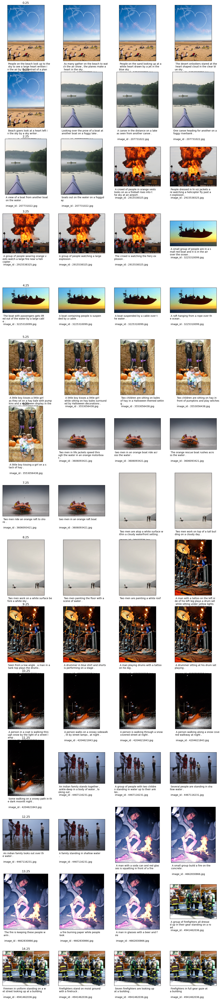

In [82]:
## show img status

back = 0
plt.figure(figsize=(16,500))
for i in range(len(non_matched_merged[back:])):
    plt.subplot(100,4,i+1)
    if i % 4 == 0:
        plt.title(f"{(i+1+back)/4}")
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    
    path = non_matched_merged['dir'][i+back] + '/' + non_matched_merged['image_id'][i+back]
    im_bgr = cv2.imread(path)
    im_rgb = im_bgr[:, :, ::-1]
    plt.imshow(im_rgb, cmap=plt.cm.binary)
    
    if non_matched_merged['caption'].isnull()[i+back]:
        plt.xlabel('image_id : '+ str(non_matched_merged['image_id'][i+back]) , loc='left', fontsize=10)
    else : 
        plt.xlabel(non_matched_merged['caption'][i+back][:35] + '\n' + non_matched_merged['caption'][i+back][35:70] + '\n' 
               + non_matched_merged['caption'][i+back][70:105] + '\n image_id : ' + str(non_matched_merged['image_id'][i+back]) , loc='left', fontsize=10)
    #plt.legend(find['image_id'][i])
plt.show()